In [3]:
# mount google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
import random
import os

import pandas as pd

# Path to testset 
path_to_testset = 'test_dataset'

df_testset = pd.read_excel(os.path.join(path_to_testset, 'donnees_IS_new.xlsx'))
display(df_testset)
# Data cleaning
list_true_y = df_testset.values.tolist()
list_true_y = [[value for value in sublist if type(value)!=float] for sublist in list_true_y]
list_true_y = [sublist for sublist in list_true_y if len(sublist)>1]

print('number of classes',len(list_true_y))
print('classes', list_true_y)

# Randomly select 32 elements from list_true_y
list_true_y = random.sample(list_true_y, 32)

print('Randomly selected 32 elements:')
print(len(list_true_y))

,Aamulehti_19111119_P10_01.jpg,turunsanomat_19111112_P5_01.jpg,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15
0,Aamulehti_19111203_P22_01.jpg,theadelaidechronicle_19120113_P30_00_03.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,bismarckdailytribune_19111114_P3_01.jpg,perthamboyeveningnews_19111109_P1_01.jpg,thechroniclenews_19111116_P1_01.jpg,thediamonddrill_19111125_P7_01.jpg,thepenascolajournal_19111119_P7_01.jpg,theseattlestar_19111102_P6_01.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,bismarckdailytribune_19111117_P1_01.jpg,DasinferessanteBlatt_19111109_P9_05.jpg,eveningbulletin_19111230_P16_01.jpg,eveningjournal_19111115_P9_01.jpg,illustracionartistica_191111113_P8_00_02.jpg,perthamboyeveningnews_19111114_P1_01.jpg,thecairobulletin_19111117_P1_01.jpg,thepenascolajournal_19111123_02.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,bismarckdailytribune_19111128_P3_01.jpg,perthamboyeveningnews_19111124_P12_01.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,perthamboyeveningnews_19111124_P12_01.jpg,thecairobulletin_19111126_P1_02.jpg,thepenascolajournal_19111126_P16_01.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67,illustration_19111209.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
68,Atro turco-arabes_Bataille-syndicaliste_1914-0...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
69,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
70,DasinferessanteBlatt_19120112_P7_02.jpg,carte_postale.jpg,matin_19111226_04.jpg,anno_19120111.jpg,anno_19120106.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


number of classes 68
classes [['Aamulehti_19111203_P22_01.jpg', 'theadelaidechronicle_19120113_P30_00_03.jpg'], ['bismarckdailytribune_19111114_P3_01.jpg', 'perthamboyeveningnews_19111109_P1_01.jpg', 'thechroniclenews_19111116_P1_01.jpg', 'thediamonddrill_19111125_P7_01.jpg', 'thepenascolajournal_19111119_P7_01.jpg', 'theseattlestar_19111102_P6_01.jpg'], ['bismarckdailytribune_19111117_P1_01.jpg', 'DasinferessanteBlatt_19111109_P9_05.jpg', 'eveningbulletin_19111230_P16_01.jpg', 'eveningjournal_19111115_P9_01.jpg', 'illustracionartistica_191111113_P8_00_02.jpg', 'perthamboyeveningnews_19111114_P1_01.jpg', 'thecairobulletin_19111117_P1_01.jpg', 'thepenascolajournal_19111123_02.jpg'], ['bismarckdailytribune_19111128_P3_01.jpg', 'perthamboyeveningnews_19111124_P12_01.jpg'], ['perthamboyeveningnews_19111124_P12_01.jpg', 'thecairobulletin_19111126_P1_02.jpg', 'thepenascolajournal_19111126_P16_01.jpg'], ['canadafrancais_19111201_P1_01.jpg', 'liverpooldailypost_19111030_P3_00_01.jpg', 'thepher

# Distribution of the data

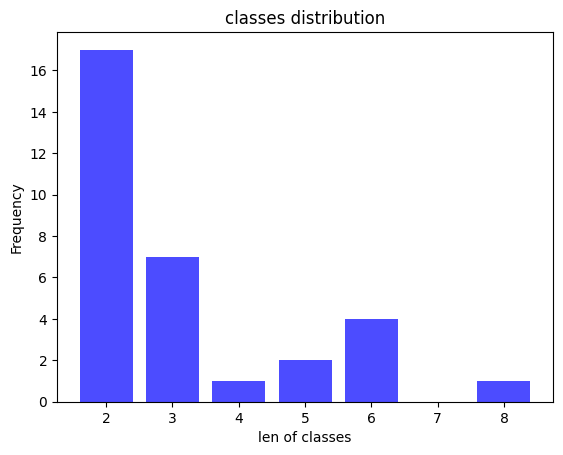

In [7]:
import matplotlib.pyplot as plt


# Plot the histogram of the classes distribution
list_distribution = [len(sublist) for sublist in list_true_y if len(sublist)>1]
dict_dist =  {i:list_distribution.count(i) for i in list_distribution}
# Garder 32 instance
# Plot the histogram
plt.bar(list(dict_dist.keys()), list(dict_dist.values()), color='blue', alpha=0.7)

plt.xlabel('len of classes')
plt.ylabel('Frequency')
plt.title('classes distribution')
plt.show()

In [8]:
import os

# Getting a list of paths in
images_path = [os.path.join(path_to_testset, value) for sublist in list_true_y for value in sublist]
print('number images for tests',len(images_path))

101


In [9]:
import clip
import torch
import numpy as np
from PIL import Image

# Load the model
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)
model.cuda().eval()


100%|███████████████████████████████████████| 338M/338M [00:04<00:00, 79.7MiB/s]


CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 768, kernel_size=(32, 32), stride=(32, 32), bias=False)
    (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): Sequential(
        (0): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          )
          (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=768, out_features=3072, bias=True)
            (gelu): QuickGELU()
            (c_proj): Linear(in_features=3072, out_features=768, bias=True)
          )
          (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        )
        (1): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          

In [15]:
def calculate_matrix_similarity(list_images_path, model):
    """
    Calculates the similarity matrix for a list of images using a given CLIP model.

    Parameters:
    - list_images_path (list): A list of file paths representing images for which the similarity matrix is to be calculated.
    - model: An instance of the CLIP model capable of encoding image embeddings.

    Returns:
    torch.Tensor: A square matrix representing the pairwise cosine similarity between the images.
    """
    list_embeddings = list()
    images = [preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0).to(device) for img_path in set(list_images_path)]
    for image in set(images):
        #image = preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0).to(device)
        with torch.no_grad():
            embeddings = model.encode_image(image)
        list_embeddings.append(embeddings)
    embeddings = torch.cat(list_embeddings, dim=0)
    normalized_embeddings = embeddings / torch.norm(embeddings, dim=1, keepdim=True)
    similarity_matrix = normalized_embeddings @ normalized_embeddings.T
    return similarity_matrix


In [11]:
import os

def formating_to_dicts(list_true_y, cutting_num, similarity_matrix, list_images_path):
    """
    Calculates the similarity matrix for a list of images using a given CLIP model.

    Parameters:
    - list_images_path (list): A list of file paths representing images for which the similarity matrix is to be calculated.
    - model: An instance of the CLIP model capable of encoding image embeddings.

    Returns:
    torch.Tensor: A square matrix representing the pairwise cosine similarity between the images.
    """
    results_dict = dict()
    images_path = list(set(list_images_path))
    ground_truth_dict = dict()
    for idx in range(similarity_matrix.shape[0]):
        img_idx_similarities = similarity_matrix[idx]

        # Exclude diagonal element (similarity to itself)
        img_idx_similarities[idx] = -float('inf')

        # Get indices and values of the best similarities
        values, indices = img_idx_similarities.sort(descending=True)
        best_similarities_indexes = indices[:cutting_num].long()
        image = os.path.basename(images_path[idx])
        results_dict[image] = []
        for sim_idx in best_similarities_indexes:
            results_dict[image].append(os.path.basename(images_path[sim_idx]))

    for key in results_dict.keys():
        basekey = os.path.basename(key)
        ground_truth_dict[basekey] = [basekey]
        for sublist in list_true_y.copy():
            if basekey in sublist:
                ground_truth_dict[basekey] = sublist.copy()
                ground_truth_dict[basekey].remove(basekey)

    return results_dict, ground_truth_dict

In [23]:
import os
import numpy as np
from matplotlib import gridspec

def calculate_ndcg(results_dict, gt_dict):
    """
    Calculates the normalized discounted cumulative gain (nDCG) score for a set of results.

    Parameters:
    - results_dict (dict): A dictionary containing image names as keys and lists of top matches as values.
    - gt_dict (dict): A dictionary containing ground truth labels for each image.

    Returns:
    float: The average nDCG score for the given results.
    """
    ndcg_values = []

    for key, top_matches in results_dict.items():
        basekey = os.path.basename(key)

        # Check if the ground truth information is available for the current image
        if basekey in gt_dict:
            ground_truth = gt_dict[basekey]

            # Calculate DCG (Discounted Cumulative Gain)
            dcg = 0
            for i, item in enumerate(top_matches):
                if item in ground_truth:
                    relevance = 1  # Assigning relevance 1 for a relevant item
                    dcg += (2 ** relevance - 1) / np.log2(i + 2)

            # Calculate ideal DCG
            ideal_dcg = sum([(2 ** 1 - 1) / np.log2(i + 2) for i in range(min(len(ground_truth), len(top_matches)))])

            # Calculate nDCG
            ndcg = dcg / ideal_dcg if ideal_dcg > 0 else 0
            ndcg_values.append(ndcg)

    # Calculate average nDCG score
    average_ndcg = np.mean(ndcg_values) if ndcg_values else 0
    return average_ndcg


def calculate_metrics(results_dict, gt_dict):
    """
    Calculates various evaluation metrics including accuracy, precision, recall, F1 score, and nDCG.

    Parameters:
    - results_dict (dict): A dictionary containing image names as keys and lists of top matches as values.
    - gt_dict (dict): A dictionary containing ground truth labels for each image.

    Returns:
    tuple: A tuple containing accuracy, precision, recall, F1 score, and nDCG score.
    """
    tp = fp = fn = 0
    total_images = len(results_dict)

    if results_dict and gt_dict:
        for key, top_matches in results_dict.items():
            basekey = os.path.basename(key)

            # Check if the ground truth information is available for the current image
            if basekey in gt_dict:
                ground_truth = gt_dict[basekey]

                # Calculate true positives
                intersection_len = len(set(ground_truth).intersection(set(top_matches)))
                tp += intersection_len

                # Calculate false positives and false negatives
                fp += len(set(top_matches) - set(ground_truth))
                fn += len(set(ground_truth) - set(top_matches))

    # Calculate precision, recall, and F1 score
    precision = tp / (tp + fp) * 100 if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) * 100 if (tp + fn) > 0 else 0
    f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

    # Calculate accuracy
    accuracy = tp / total_images * 100 if total_images > 0 else 0

    # Calculate nDCG score
    ndcg_score = calculate_ndcg(results_dict, gt_dict) * 100

    return accuracy, precision, recall, f1_score, ndcg_score


def plot_subplots(reference_image_path, similar_images_paths):
    """
    Plots a set of images in subplots, with the reference image and its similar images side by side.

    Parameters:
    - reference_image_path (str): The file path to the reference image.
    - similar_images_paths (list): A list of file paths representing similar images to the reference.

    Returns: None
    """
    fig = plt.figure(figsize=(100, 50))
    gs = gridspec.GridSpec(1, 9, width_ratios=[1, 1, 1, 1, 1, 1, 1, 1, 1])

    # Plot reference image
    ax0 = plt.subplot(gs[0])
    ax0.imshow(plt.imread(reference_image_path), cmap='gray')
    ax0.set_title("Reference")

    # Plot similar images
    for i, sim_image_path in enumerate(similar_images_paths):
        ax = plt.subplot(gs[i + 1])
        ax.imshow(plt.imread(sim_image_path), cmap='gray')
        ax.set_title(f"Similar {i + 1}")

    plt.show()


In [16]:
# calculating the main class length
mean_distribution = max(dict_dist, key=dict_dist.get)
print('cutting_num',mean_distribution-1)
# calculating the similarity matrix
similarity_matrix = calculate_matrix_similarity(images_path, model)
print('similarity_matrix', similarity_matrix.shape)


print()
# Calculating the metrics
result_dict_top1_accuracy, ground_truth_dict =  formating_to_dicts(list_true_y, mean_distribution-1, similarity_matrix, images_path)
accuracy, precision, recall, f1_score, ndcg_score = calculate_metrics(result_dict_top1_accuracy, ground_truth_dict)


print('accuracy', accuracy)
print('precision', precision)
print('recall', recall)
print('f1_score', f1_score)
print('ndcg_score', ndcg_score)

cutting_num 1
similarity_matrix torch.Size([98, 98])

accuracy 4.081632653061225
precision 4.081632653061225
recall 1.4285714285714286
f1_score 2.1164021164021163
ndcg_score 4.081632653061225


In [17]:
# calculating metrics for 9 images
result_dict_top1_accuracy, ground_truth_dict =  formating_to_dicts(list_true_y, 8, similarity_matrix, images_path)
accuracy, precision, recall, f1_score, ndcg_score = calculate_metrics(result_dict_top1_accuracy, ground_truth_dict)
print('accuracy', accuracy)
print('precision', precision)
print('recall', recall)
print('f1_score', f1_score)
print('ndcg_score', ndcg_score)


accuracy 19.387755102040817
precision 2.423469387755102
recall 6.785714285714286
f1_score 3.571428571428571
ndcg_score 4.811325754541136


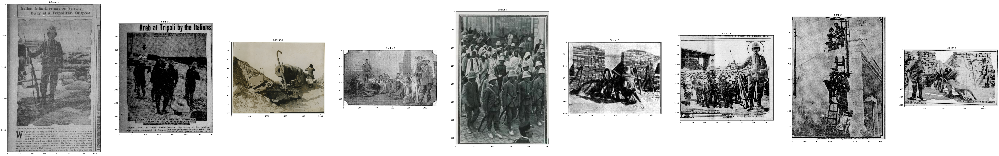

In [26]:
# Plot subplots for the first result
reference_image_path = os.path.join("test_dataset", list(result_dict_top1_accuracy.keys())[1])
similar_images_paths = [os.path.join("test_dataset", img) for img in result_dict_top1_accuracy[list(result_dict_top1_accuracy.keys())[1]]]
plot_subplots(reference_image_path, similar_images_paths)

# Fine-tuning

In [ ]:
# load the model
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [42]:
# Unzipping the train set
!unzip '/content/drive/MyDrive/training_set/training_set.zip' -d '.'

Archive:  /content/drive/MyDrive/training_set/training_set.zip
   creating: ./training_set/
  inflating: ./training_set/np_guerreillustree_191812_16_04.jpg  
  inflating: ./training_set/np_surlevif_19160226_07_02.jpg  
  inflating: ./training_set/np_guerreillustree_191805_25_01.jpg  
  inflating: ./training_set/np_surlevif_19161125_06_02.jpg  
  inflating: ./training_set/np_surlevif_19160318_06_01.jpg  
  inflating: ./training_set/np_surlevif_19160715_05_04.jpg  
  inflating: ./training_set/np_guerreillustree_191810_07_02.jpg  
  inflating: ./training_set/np_surlevif_19161118_11_03.jpg  
  inflating: ./training_set/np_guerreillustree_191610_10_01.jpg  
  inflating: ./training_set/np_surlevif_19161111_12_01.jpg  
  inflating: ./training_set/np_guerreillustree_191703_09_02.jpg  
  inflating: ./training_set/np_guerreillustree_191709_13_01.jpg  
  inflating: ./training_set/np_surlevif_19160722_08_06.jpg  
  inflating: ./training_set/pho_2K24780_34_01.jpg  
  inflating: ./training_set/np_gu

In [49]:
import pandas as pd

# Path to trainset
PATH_TO_TRANSLATED_LEGENDS = 'training_set/df_training_translated.xlsx'
df = pd.read_excel(PATH_TO_TRANSLATED_LEGENDS)
# not considering long legends
df = df[df["legend"].apply(len)<77]
display(df)
print('number of classes',len(set(df["legend"].str.lower().tolist())))

,Unnamed: 0,image_name,legend
0,0,pho_2K24795_04_01.jpg,FORBIN DELAGEMENT
1,1,pho_2K24795_04_02.jpg,FORBIN DELAGEMENT
2,2,pho_2K24795_06_01.jpg,forbin
3,3,pho_2K24795_06_02.jpg,forbin
8,8,pho_2K24795_20_01.jpg,Forbin La Muqiue in Salonica
...,...,...,...
3695,3695,np_surlevif_19160219_04_06.jpg,65 battery sheltered behind a hill in a living...
3710,3710,np_surlevif_19160219_08_06.jpg,"Trenches dug in the cemetery of S…, by the Ger..."
3743,3743,np_surlevif_19160415_11_01.jpg,command levels
3744,3744,np_surlevif_19160415_11_02.jpg,underground work


number of classes 1796


In [ ]:
from PIL import Image
import numpy as np
import pandas as pd

import torch
import torch.nn as nn
from torch.utils.data import DataLoader
import clip


# Load the model
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)


PATH_TO_TRAININGSET = './training_set/training_set'

In [ ]:
class image_legends_dataset():
    """
    Custom dataset class for pairing images with corresponding textual legends.

    Parameters:
    - list_image_path (list): A list of file paths representing images.
    - list_txt (list): A list of textual legends corresponding to the images.
    - transform (callable, optional): A function or transform to apply to the images. Default is None.

    Methods:
    - __len__(): Returns the total number of samples in the dataset.
    - __getitem__(idx): Returns the preprocessed image and corresponding legend at the given index.

    Note:
    - The class utilizes the CLIP tokenizer to tokenize the textual legends.
    - The images are expected to be in RGB format.
    - The `transform` parameter can be used to apply custom transformations to the images.
    """
    def __init__(self, list_image_path, list_txt, transform=None):
        # Initialize image paths and corresponding texts
        self.image_path = list_image_path
        self.legends = clip.tokenize(list_txt) #, context_length=self.max_token_length
        self.transform = transform
    def __len__(self):
        return len(self.legends)

    def __getitem__(self, idx):
        # Preprocess image using CLIP's preprocessing function
        image = preprocess(Image.open(self.image_path[idx]).convert('RGB'))
        legend = self.legends[idx]
        return image, legend


In [ ]:
import os

# adding prompt to the legends
prompt = 'This is a photo of '
list_image_path_train = [os.path.join(PATH_TO_TRAININGSET, img) for img in df['image_name']]
list_txt_train = [prompt+legend for legend in df['legend']]
print('len_data',len(list_txt_train))

# creating the dataset
train_dataset = image_legends_dataset(list_image_path_train, list_txt_train)
print('len_after_class',len(train_dataset))

['./training_set/training_set/pho_2K24795_04_01.jpg', './training_set/training_set/pho_2K24795_04_02.jpg', './training_set/training_set/pho_2K24795_06_01.jpg', './training_set/training_set/pho_2K24795_06_02.jpg', './training_set/training_set/pho_2K24795_20_01.jpg', './training_set/training_set/pho_2K24795_20_02.jpg', './training_set/training_set/pho_2K24795_23_01.jpg', './training_set/training_set/pho_2K24795_23_02.jpg', './training_set/training_set/pho_2K24795_31_02.jpg', './training_set/training_set/pho_2K24795_32_01.jpg', './training_set/training_set/pho_2K24795_32_02.jpg', './training_set/training_set/pho_2K24795_33_01.jpg', './training_set/training_set/pho_2K24795_33_02.jpg', './training_set/training_set/pho_2K24795_34_01.jpg', './training_set/training_set/pho_2K24795_34_02.jpg', './training_set/training_set/pho_2K24795_35_01.jpg', './training_set/training_set/pho_2K24795_35_02.jpg', './training_set/training_set/pho_2K24795_38_03.jpg', './training_set/training_set/pho_2K4716_01_01

In [ ]:
from torch.utils.data import random_split

# Define the size of the validation set (e.g., 20%)
validation_set_size = int(0.2 * len(train_dataset))

# Split the dataset into training and validation sets
train_set, val_set = random_split(train_dataset, [len(train_dataset) - validation_set_size, validation_set_size])

# Print the sizes of the training and validation sets
print(f"Training set size: {len(train_dataset)}")
print(f"Validation set size: {len(val_set)}")

Training set size: 2040
Validation set size: 408


In [ ]:
from torch.utils.data import DataLoader

# Define batch size
batch_size = 100

# Create data loaders for training and validation sets
train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=False)


In [ ]:
# Validation function
def validate(model, val_loader, criterion_img, criterion_txt, device):
    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for val_batch in val_loader:
            val_images, val_texts = val_batch
            val_images = val_images.to(device)
            val_texts = val_texts.to(device)

            val_logits_per_image, val_logits_per_text = model(val_images, val_texts)

            val_ground_truth = torch.arange(len(val_images), dtype=torch.long, device=device)
            val_loss += (criterion_img(val_logits_per_image, val_ground_truth).cpu() +
                          criterion_txt(val_logits_per_text, val_ground_truth).cpu()) / 2

    return val_loss / len(val_loader)

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 0/100, Training Loss: 3.2873, Validation Loss: 2.8945
<class 'float'>


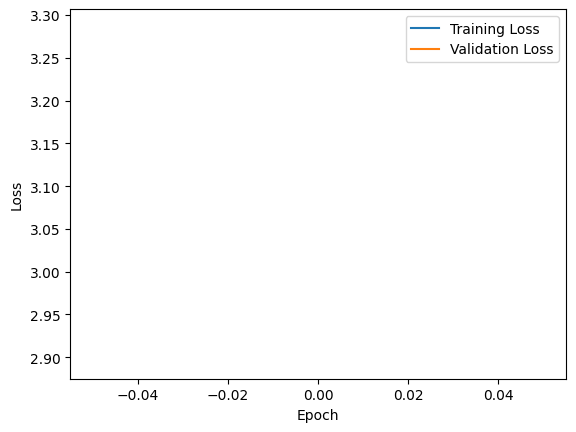

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 1/100, Training Loss: 2.9088, Validation Loss: 2.8418
<class 'float'>


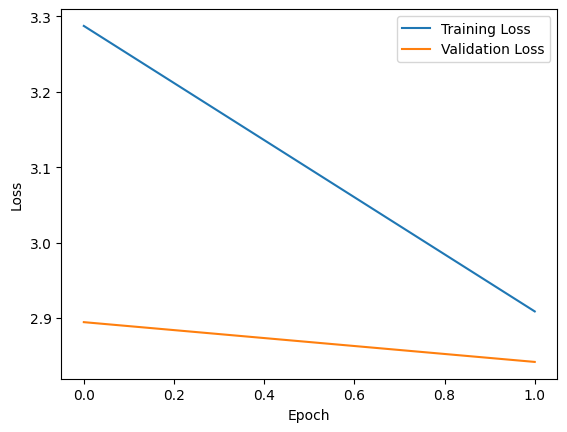

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 2/100, Training Loss: 2.8135, Validation Loss: 2.7930
<class 'float'>


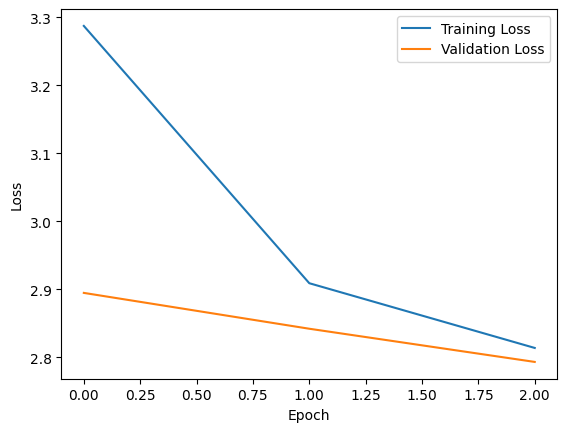

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 3/100, Training Loss: 2.6679, Validation Loss: 2.7578
<class 'float'>


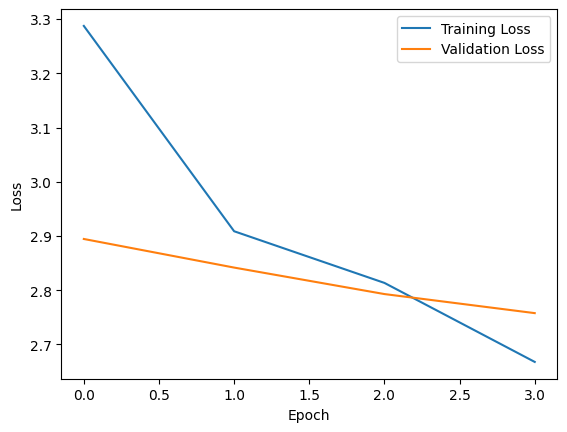

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 4/100, Training Loss: 2.5977, Validation Loss: 2.7227
<class 'float'>


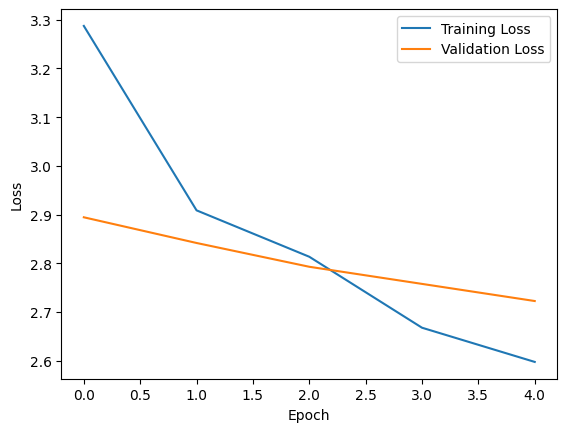

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 5/100, Training Loss: 2.5094, Validation Loss: 2.6934
<class 'float'>


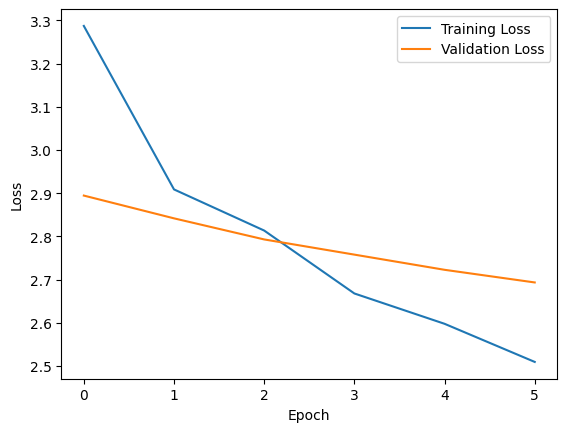

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 6/100, Training Loss: 2.4521, Validation Loss: 2.6699
<class 'float'>


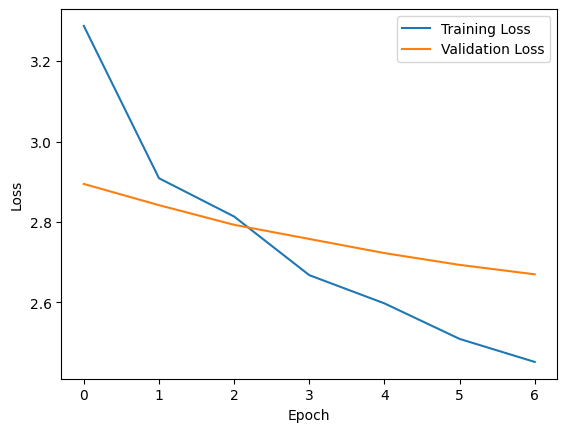

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 7/100, Training Loss: 2.3560, Validation Loss: 2.6504
<class 'float'>


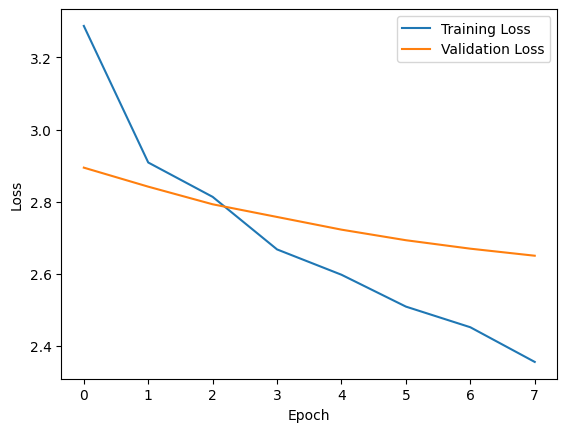

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 8/100, Training Loss: 2.3181, Validation Loss: 2.6328
<class 'float'>


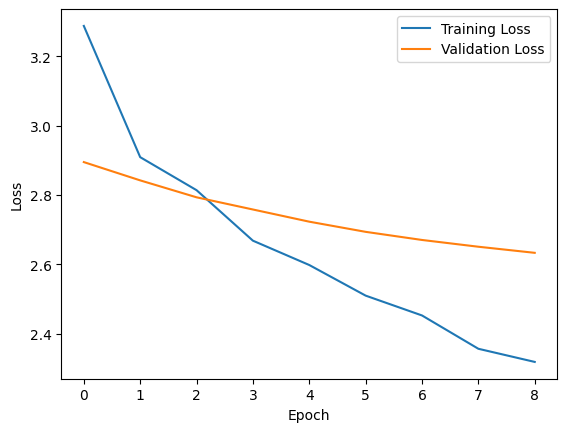

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 9/100, Training Loss: 2.2554, Validation Loss: 2.6211
<class 'float'>


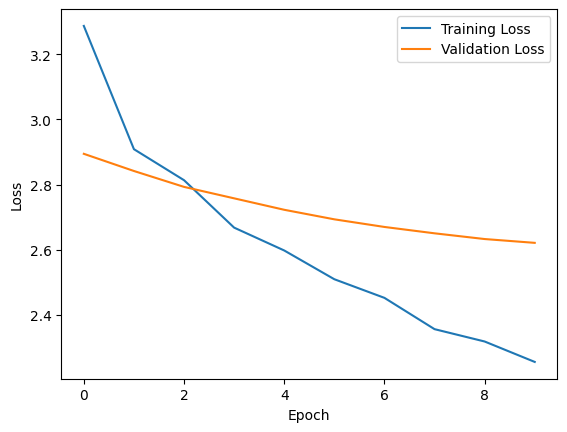

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 10/100, Training Loss: 2.1965, Validation Loss: 2.6055
<class 'float'>


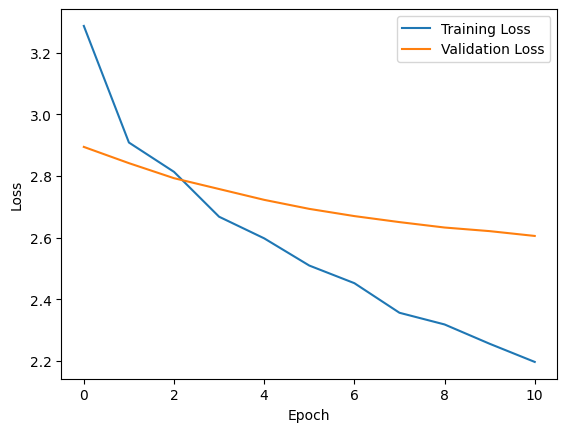

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 11/100, Training Loss: 2.1254, Validation Loss: 2.5938
<class 'float'>


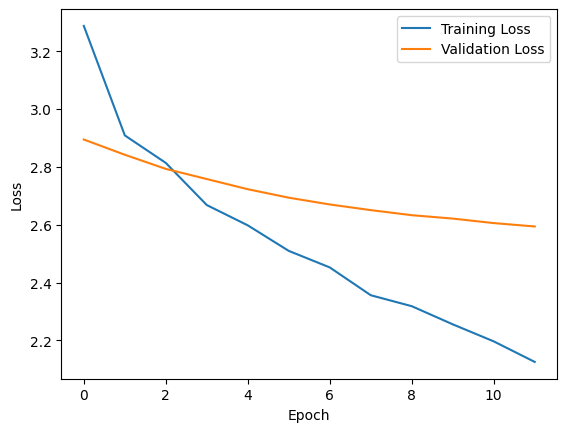

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 12/100, Training Loss: 2.0605, Validation Loss: 2.5859
<class 'float'>


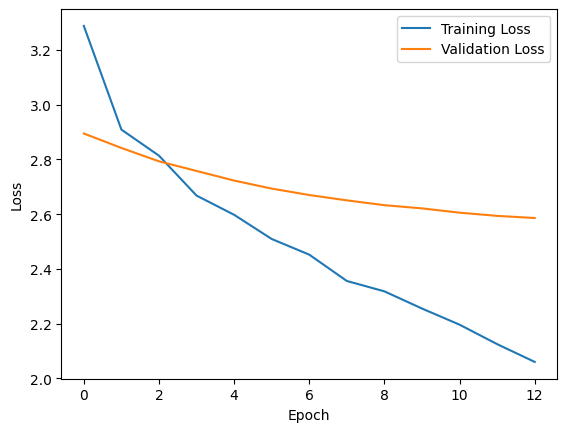

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 13/100, Training Loss: 2.0139, Validation Loss: 2.5801
<class 'float'>


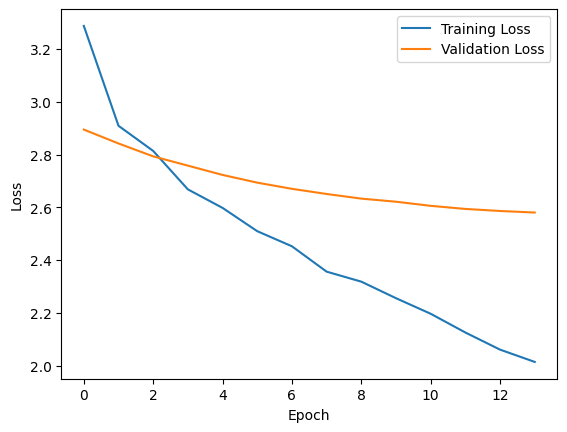

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 14/100, Training Loss: 1.9458, Validation Loss: 2.5762
<class 'float'>


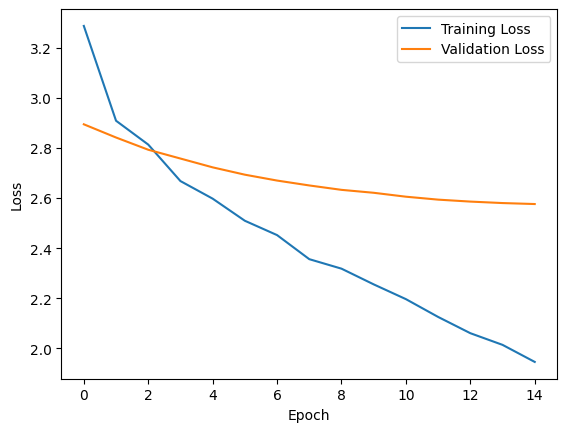

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 15/100, Training Loss: 1.9304, Validation Loss: 2.5684
<class 'float'>


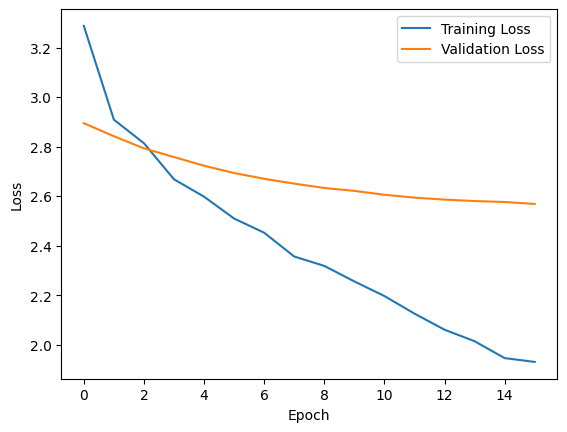

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 16/100, Training Loss: 1.9082, Validation Loss: 2.5645
<class 'float'>


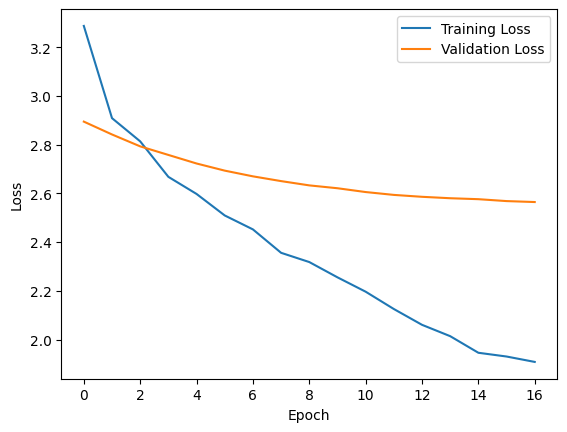

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 17/100, Training Loss: 1.8336, Validation Loss: 2.5625
<class 'float'>


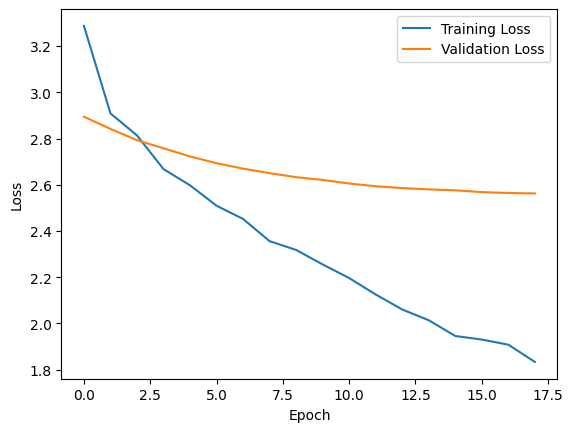

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 18/100, Training Loss: 1.7874, Validation Loss: 2.5625
<class 'float'>


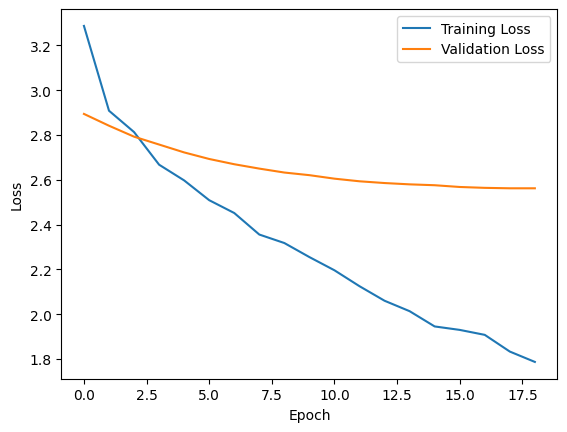

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 19/100, Training Loss: 1.7521, Validation Loss: 2.5586
<class 'float'>


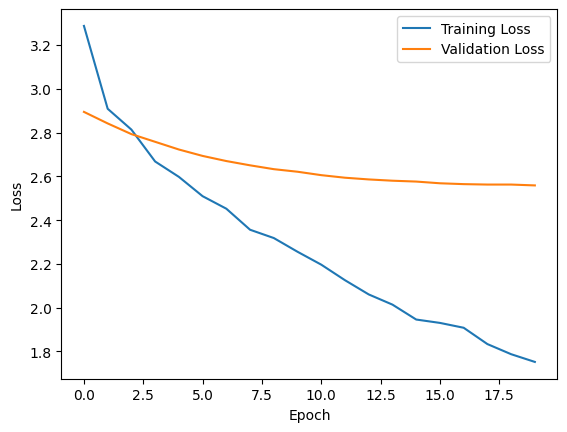

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 20/100, Training Loss: 1.6922, Validation Loss: 2.5625
<class 'float'>


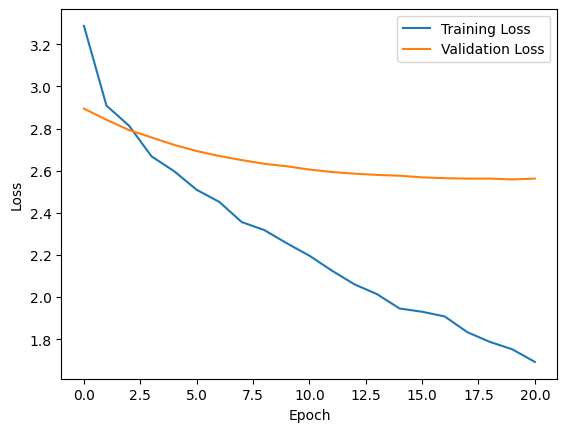

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 21/100, Training Loss: 1.6486, Validation Loss: 2.5625
<class 'float'>


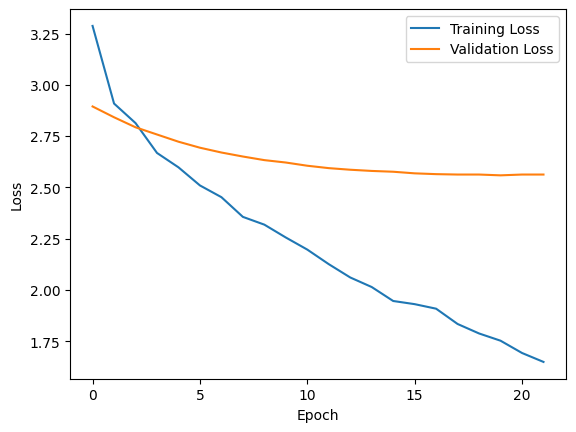

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 22/100, Training Loss: 1.6278, Validation Loss: 2.5586
<class 'float'>


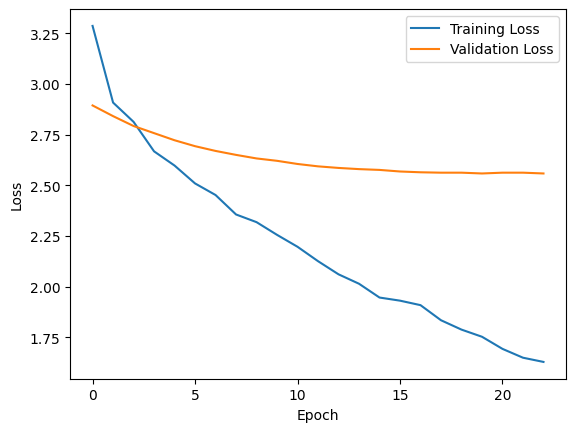

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 23/100, Training Loss: 1.5636, Validation Loss: 2.5586
<class 'float'>


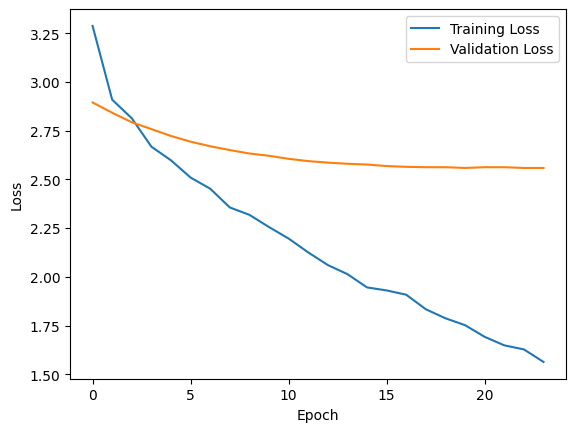

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 24/100, Training Loss: 1.5446, Validation Loss: 2.5645
<class 'float'>


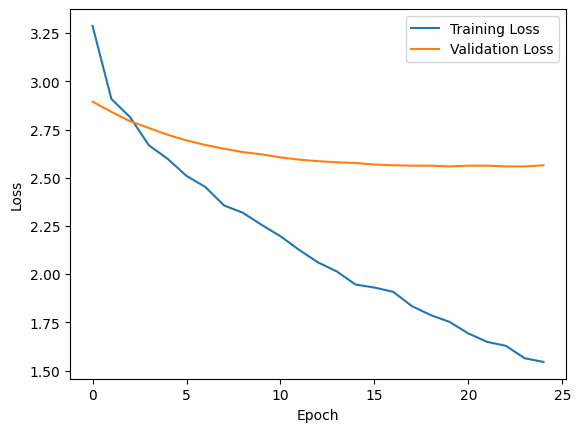

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 25/100, Training Loss: 1.4723, Validation Loss: 2.5664
<class 'float'>


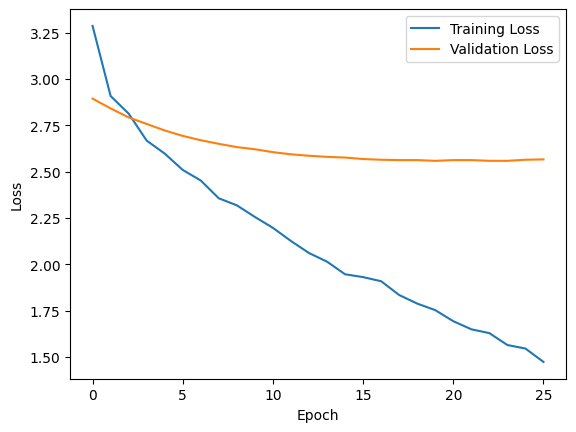

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 26/100, Training Loss: 1.4343, Validation Loss: 2.5742
<class 'float'>


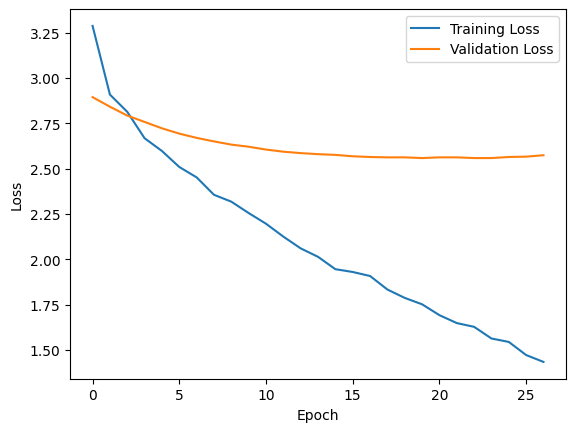

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 27/100, Training Loss: 1.3866, Validation Loss: 2.5762
<class 'float'>


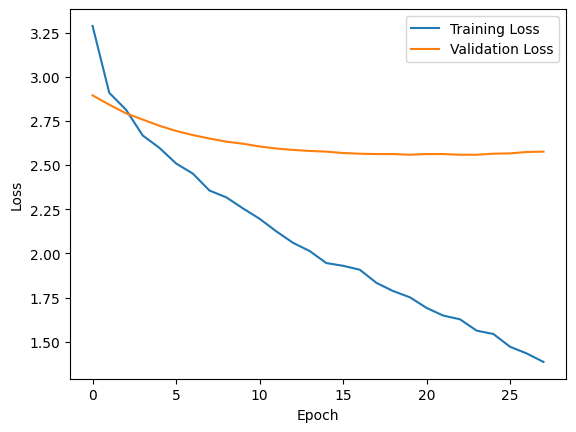

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 28/100, Training Loss: 1.3566, Validation Loss: 2.5820
<class 'float'>


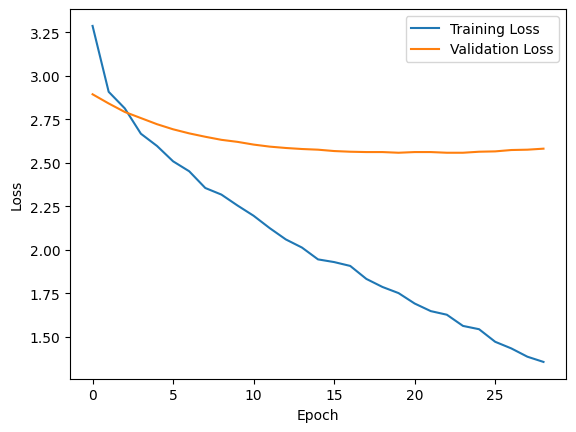

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 29/100, Training Loss: 1.3065, Validation Loss: 2.5879
<class 'float'>


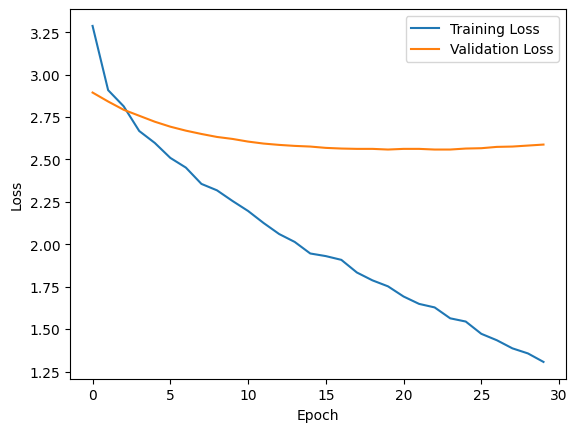

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 30/100, Training Loss: 1.2732, Validation Loss: 2.5938
<class 'float'>


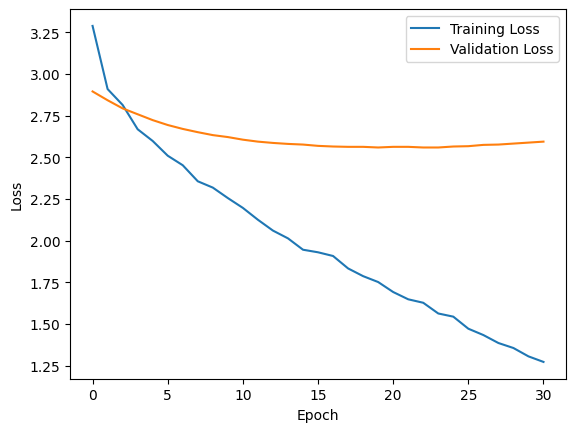

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 31/100, Training Loss: 1.2649, Validation Loss: 2.6035
<class 'float'>


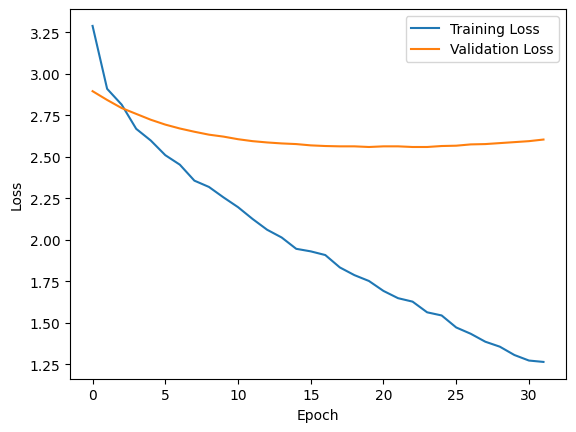

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 32/100, Training Loss: 1.2032, Validation Loss: 2.6094
<class 'float'>


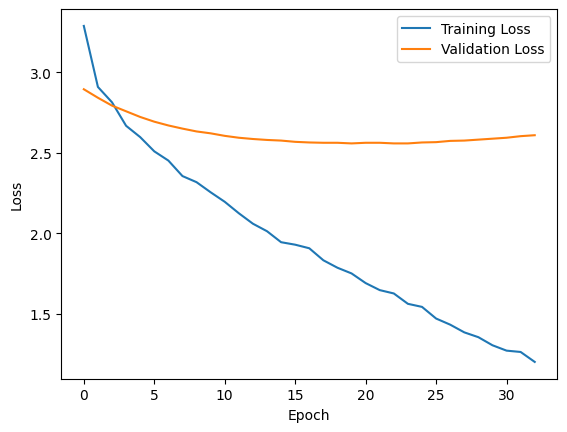

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 33/100, Training Loss: 1.1791, Validation Loss: 2.6211
<class 'float'>


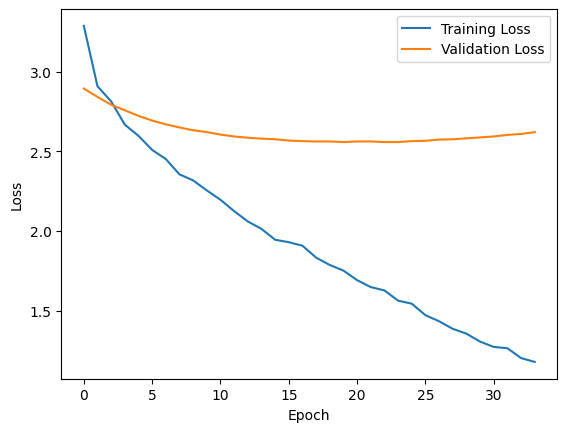

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 34/100, Training Loss: 1.1177, Validation Loss: 2.6289
<class 'float'>


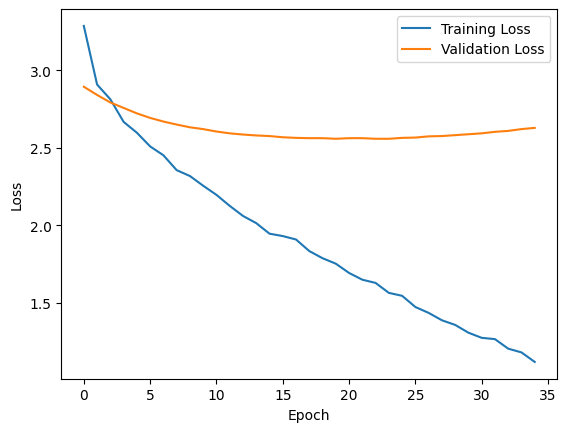

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 35/100, Training Loss: 1.0898, Validation Loss: 2.6406
<class 'float'>


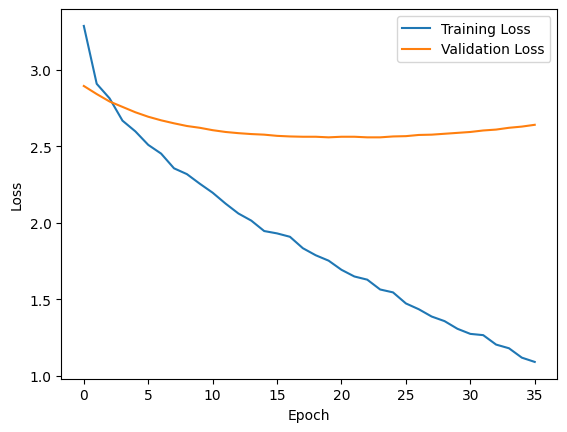

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 36/100, Training Loss: 1.0596, Validation Loss: 2.6523
<class 'float'>


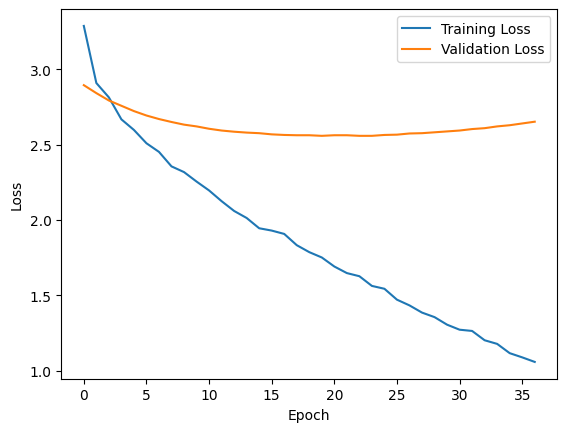

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 37/100, Training Loss: 1.0314, Validation Loss: 2.6602
<class 'float'>


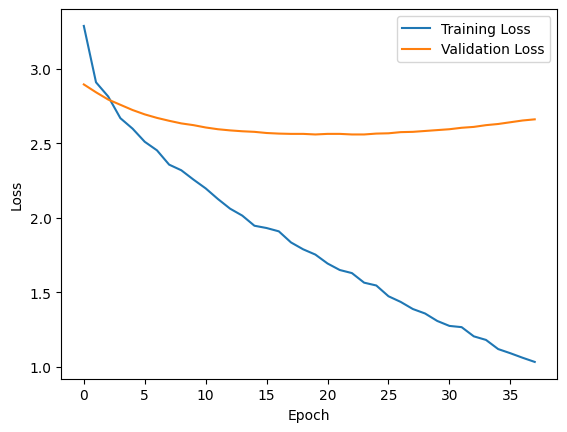

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 38/100, Training Loss: 1.0058, Validation Loss: 2.6719
<class 'float'>


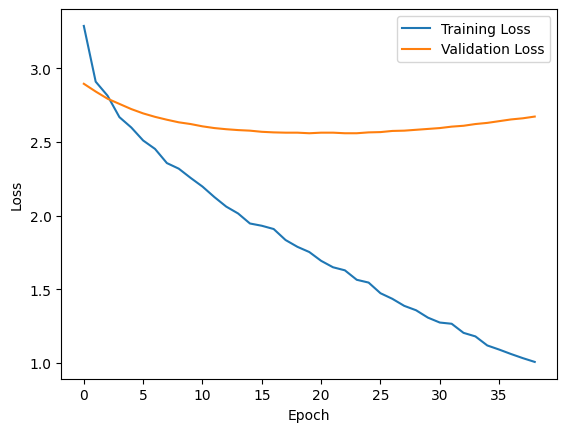

  0%|          | 0/17 [00:00<?, ?it/s]

Epoch 39/100, Training Loss: 0.9684, Validation Loss: 2.6836
<class 'float'>


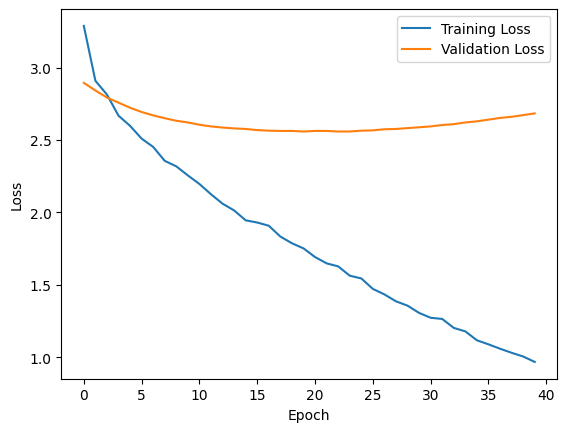

Early stopping after 20 epochs without improvement.


In [ ]:
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt

# defening hyperparameters
patience = 20
num_epochs = 128
best_val_loss = float('inf')
current_patience = 0
optimizer = torch.optim.Adam(model.parameters(), lr=1e-6,betas=(0.9,0.98),eps=1e-6,weight_decay=0.2)
loss_img = nn.CrossEntropyLoss()
loss_txt = nn.CrossEntropyLoss()

# Lists to store training and validation losses
train_losses = []
val_losses = []

# Training loop
for epoch in range(num_epochs):
    model.train()
    pbar = tqdm(train_loader, total=len(train_loader))
    total_train_loss = 0.0

    for batch in pbar:
        optimizer.zero_grad()

        images, texts = batch
        images = images.to(device)
        texts = texts.to(device)
        #texts = torch.reshape(texts, (1, 16, 1, 77))
        # print('text shape',texts.shape)
        # print('image shape',images.shape)

        logits_per_image, logits_per_text = model(images, texts)

        ground_truth = torch.arange(len(images), dtype=torch.long, device=device)
        total_loss = (loss_img(logits_per_image, ground_truth).cpu() + loss_txt(logits_per_text, ground_truth).cpu()) / 2

        total_loss.backward()
        optimizer.step()

        total_train_loss += total_loss.item()
        pbar.set_description(f"Epoch {epoch}/{num_epochs}, Loss: {total_loss.item():.4f}")

    # Calculate training loss
    average_train_loss = total_train_loss / len(train_loader)
    train_losses.append(average_train_loss)

    # Validate and calculate validation loss
    val_loss = validate(model, val_loader, loss_img, loss_txt, device)
    val_losses.append(val_loss)

    # Print and plot losses
    print(f"Epoch {epoch}/{num_epochs}, Training Loss: {average_train_loss:.4f}, Validation Loss: {val_loss:.4f}")

    # Check for early stopping
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        current_patience = 0
        # Save the model when validation loss improves
        torch.save(model.state_dict(), "./best_model.pth")
    else:
        current_patience += 1

    print(type(train_losses[0]))
    # Plot training and validation losses
    #plot_train_losses  = [x.cpu() for x in train_losses]

    #plot_val_losses  = [x.cpu() for x in val_losses]
    plt.plot(train_losses, label='Training Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

    # Check if early stopping condition is met
    if current_patience >= patience:
        print(f"Early stopping after {patience} epochs without improvement.")
        break

In [49]:
import clip
import torch

PATH_TO_MODEL_WEIGHTS = 'best_model.pth'
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)

state_dict = torch.load(PATH_TO_MODEL_WEIGHTS, map_location='cuda' if torch.cuda.is_available() else 'cpu')
model.load_state_dict(state_dict)
model.cuda().eval()

CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 768, kernel_size=(32, 32), stride=(32, 32), bias=False)
    (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): Sequential(
        (0): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          )
          (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=768, out_features=3072, bias=True)
            (gelu): QuickGELU()
            (c_proj): Linear(in_features=3072, out_features=768, bias=True)
          )
          (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        )
        (1): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          

In [50]:
def calculate_matrix_similarity(list_images_path, model):
    list_embeddings = list()
    images = [preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0).to(device) for img_path in set(list_images_path)]
    for image in set(images):
        #image = preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0).to(device)
        with torch.no_grad():
            embeddings = model.encode_image(image)
        list_embeddings.append(embeddings)
    embeddings = torch.cat(list_embeddings, dim=0)
    normalized_embeddings = embeddings / torch.norm(embeddings, dim=1, keepdim=True)
    similarity_matrix = normalized_embeddings @ normalized_embeddings.T
    return similarity_matrix


In [54]:
similarity_matrix = calculate_matrix_similarity(images_path, model)
result_dict_top1_accuracy, ground_truth_dict =  formating_to_dicts(list_true_y, mean_distribution-1, similarity_matrix, images_path)
accuracy, precision, recall, f1_score, ndcg_score = calculate_metrics(result_dict_top1_accuracy, ground_truth_dict)
print('accuracy', accuracy)
print('precision', precision)
print('recall', recall)
print('f1_score', f1_score)
print('ndcg_score', ndcg_score)

accuracy 2.0408163265306123
precision 2.0408163265306123
recall 0.7142857142857143
f1_score 1.0582010582010581
ndcg_score 2.0408163265306123


In [55]:
result_dict_top1_accuracy, ground_truth_dict =  formating_to_dicts(list_true_y, 8, similarity_matrix, images_path)
accuracy, precision, recall, f1_score, ndcg_score = calculate_metrics(result_dict_top1_accuracy, ground_truth_dict)
print('accuracy', accuracy)
print('precision', precision)
print('recall', recall)
print('f1_score', f1_score)
print('ndcg_score', ndcg_score)

accuracy 23.46938775510204
precision 2.933673469387755
recall 8.214285714285714
f1_score 4.323308270676692
ndcg_score 4.821302258384297


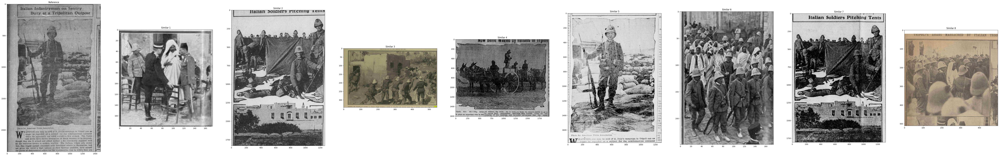

In [53]:
# Plot subplots for the first result
reference_image_path = os.path.join("test_dataset", list(result_dict_top1_accuracy.keys())[1])
similar_images_paths = [os.path.join("test_dataset", img) for img in result_dict_top1_accuracy[list(result_dict_top1_accuracy.keys())[1]]]
plot_subplots(reference_image_path, similar_images_paths)

# Fine tuning with data augmentation on images


In [ ]:
! pip install --upgrade git+https://github.com/openai/CLIP.git

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-_7tntpnh
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-_7tntpnh
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Unzipping the train set

#! mkdir training_set
!unzip '/content/drive/MyDrive/training_set/training_set.zip' -d '.'

Archive:  /content/drive/MyDrive/training_set/training_set.zip
  inflating: ./training_set/np_guerreillustree_191812_16_04.jpg  
  inflating: ./training_set/np_surlevif_19160226_07_02.jpg  
  inflating: ./training_set/np_guerreillustree_191805_25_01.jpg  
  inflating: ./training_set/np_surlevif_19161125_06_02.jpg  
  inflating: ./training_set/np_surlevif_19160318_06_01.jpg  
  inflating: ./training_set/np_surlevif_19160715_05_04.jpg  
  inflating: ./training_set/np_guerreillustree_191810_07_02.jpg  
  inflating: ./training_set/np_surlevif_19161118_11_03.jpg  
  inflating: ./training_set/np_guerreillustree_191610_10_01.jpg  
  inflating: ./training_set/np_surlevif_19161111_12_01.jpg  
  inflating: ./training_set/np_guerreillustree_191703_09_02.jpg  
  inflating: ./training_set/np_guerreillustree_191709_13_01.jpg  
  inflating: ./training_set/np_surlevif_19160722_08_06.jpg  
  inflating: ./training_set/pho_2K24780_34_01.jpg  
  inflating: ./training_set/np_guerreillustree_191812_18_01.jp

In [86]:
import pandas as pd

PATH_TO_TRANSLATED_LEGENDS = 'training_set/df_training_translated.xlsx'
df = pd.read_excel(PATH_TO_TRANSLATED_LEGENDS)
df = df[df["legend"].apply(len)<77]
display(df)

,Unnamed: 0,image_name,legend
0,0,pho_2K24795_04_01.jpg,FORBIN DELAGEMENT
1,1,pho_2K24795_04_02.jpg,FORBIN DELAGEMENT
2,2,pho_2K24795_06_01.jpg,forbin
3,3,pho_2K24795_06_02.jpg,forbin
8,8,pho_2K24795_20_01.jpg,Forbin La Muqiue in Salonica
...,...,...,...
3695,3695,np_surlevif_19160219_04_06.jpg,65 battery sheltered behind a hill in a living...
3710,3710,np_surlevif_19160219_08_06.jpg,"Trenches dug in the cemetery of S…, by the Ger..."
3743,3743,np_surlevif_19160415_11_01.jpg,command levels
3744,3744,np_surlevif_19160415_11_02.jpg,underground work


In [87]:
from PIL import Image

import torch
import torch.nn as nn
from torch.utils.data import DataLoader
import pandas as pd
import clip
import numpy as np

device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)


PATH_TO_TRAININGSET = './training_set'

In [88]:
from torch.utils.data import Dataset
from torchvision.transforms import v2
from PIL import Image
import clip
import os

class image_legends_dataset(Dataset):
    def __init__(self, list_image_path, list_txt, transform=None):
        self.image_path = list_image_path
        self.legends = clip.tokenize(list_txt)
        self.transform = transform

    def __len__(self):
        return len(self.legends)

    def __getitem__(self, idx):
        image = preprocess(Image.open(self.image_path[idx]).convert('RGB'))
        legend = self.legends[idx]

        if self.transform:
            image = self.transform(image)

        return image, legend



transforms = v2.Compose([
    v2.ToTensor(),
    v2.RandomResizedCrop(size=(224, 224), antialias=True),
    v2.RandomRotation(degrees=(0, 180)),
    v2.RandomHorizontalFlip(p=0.5),
    v2.RandomChannelPermutation(),
    v2.RandomVerticalFlip(p=0.5),
    v2.ColorJitter(brightness=.5, hue=.3),
    v2.GaussianBlur(kernel_size=(5, 9), sigma=(0.1, 5.)),
    v2.RandomInvert(0.5),
    v2.RandomAutocontrast(0.5),
])

prompt = 'This is a photo of '
list_image_path_train = [os.path.join(PATH_TO_TRAININGSET, img) for img in df['image_name']]
print(list_image_path_train)
list_txt_train = [prompt+legend for legend in df['legend']]
print('len_data',len(list_txt_train))
train_dataset = image_legends_dataset(list_image_path_train, list_txt_train, transform=transforms)
print('len_after_class',len(train_dataset))



/usr/local/lib/python3.10/dist-packages/torchvision/transforms/v2/_deprecated.py:43: UserWarning: The transform `ToTensor()` is deprecated and will be removed in a future release. Instead, please use `v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])`.
  warnings.warn(


['./training_set/pho_2K24795_04_01.jpg', './training_set/pho_2K24795_04_02.jpg', './training_set/pho_2K24795_06_01.jpg', './training_set/pho_2K24795_06_02.jpg', './training_set/pho_2K24795_20_01.jpg', './training_set/pho_2K24795_20_02.jpg', './training_set/pho_2K24795_23_01.jpg', './training_set/pho_2K24795_23_02.jpg', './training_set/pho_2K24795_31_02.jpg', './training_set/pho_2K24795_32_01.jpg', './training_set/pho_2K24795_32_02.jpg', './training_set/pho_2K24795_33_01.jpg', './training_set/pho_2K24795_33_02.jpg', './training_set/pho_2K24795_34_01.jpg', './training_set/pho_2K24795_34_02.jpg', './training_set/pho_2K24795_35_01.jpg', './training_set/pho_2K24795_35_02.jpg', './training_set/pho_2K24795_38_03.jpg', './training_set/pho_2K4716_01_01.jpg', './training_set/pho_2K4716_01_02.jpg', './training_set/pho_2K4716_01_03.jpg', './training_set/pho_2K4716_02_01.jpg', './training_set/pho_2K4716_02_02.jpg', './training_set/pho_2K4716_03_01.jpg', './training_set/pho_2K4716_03_02.jpg', './tra

In [89]:
from torch.utils.data import random_split

# Define the size of the validation set (e.g., 20%)
validation_set_size = int(0.2 * len(train_dataset))

# Split the dataset into training and validation sets
train_set, val_set = random_split(train_dataset, [len(train_dataset) - validation_set_size, validation_set_size])

# Print the sizes of the training and validation sets
print(f"Training set size: {len(train_dataset)}")
print(f"Validation set size: {len(val_set)}")

Training set size: 2040
Validation set size: 408


In [ ]:
from torch.utils.data import DataLoader

# Define batch size
batch_size = 128

# Create data loaders for training and validation sets
train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=False)

In [ ]:
# Validation function
def validate(model, val_loader, criterion_img, criterion_txt, device):
    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for val_batch in val_loader:
            val_images, val_texts = val_batch
            val_images = val_images.to(device)
            val_texts = val_texts.to(device)

            val_logits_per_image, val_logits_per_text = model(val_images, val_texts)

            val_ground_truth = torch.arange(len(val_images), dtype=torch.long, device=device)
            val_loss += (criterion_img(val_logits_per_image, val_ground_truth).cpu() +
                          criterion_txt(val_logits_per_text, val_ground_truth).cpu()) / 2

    return val_loss / len(val_loader)

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 0/100, Training Loss: 4.9793, Validation Loss: 4.6406
<class 'float'>


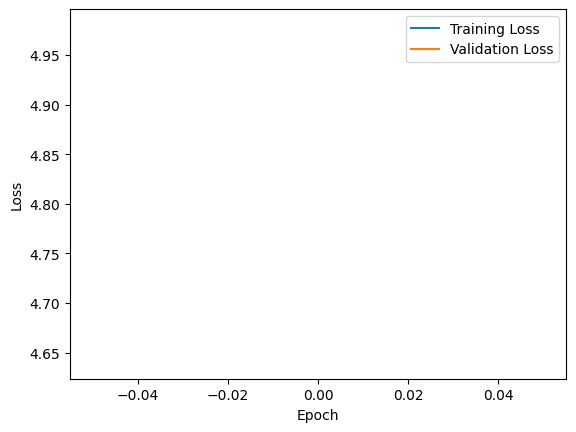

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 1/100, Training Loss: 4.9038, Validation Loss: 4.6289
<class 'float'>


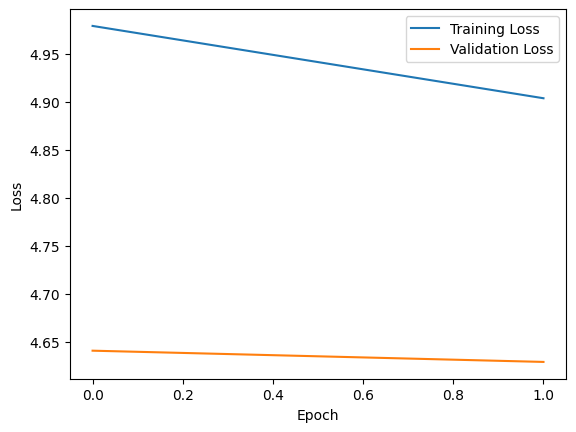

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 2/100, Training Loss: 4.8537, Validation Loss: 4.4922
<class 'float'>


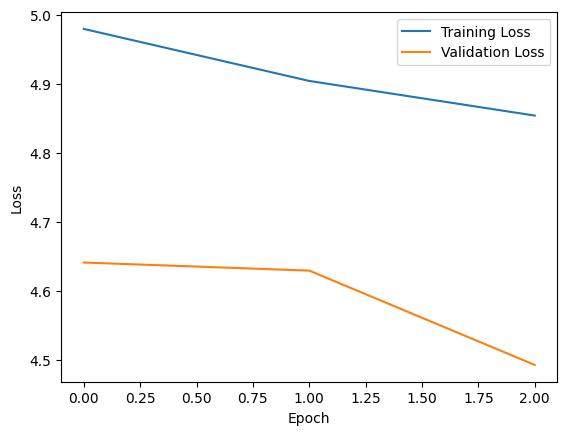

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 3/100, Training Loss: 4.8167, Validation Loss: 4.4883
<class 'float'>


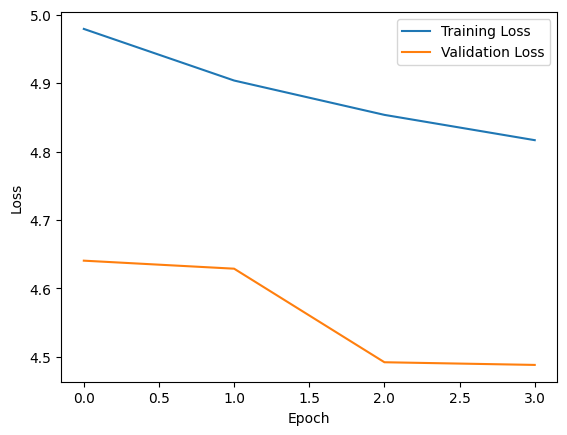

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 4/100, Training Loss: 4.7891, Validation Loss: 4.4180
<class 'float'>


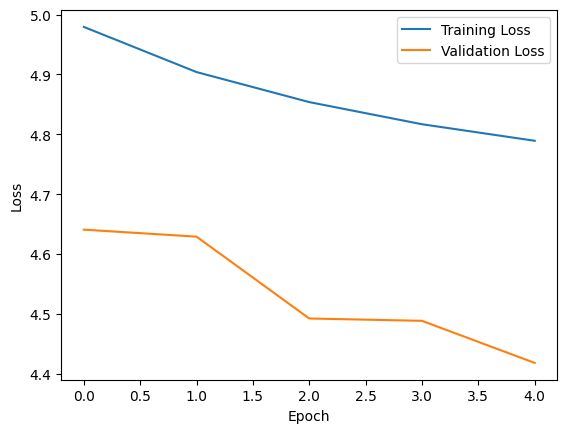

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 5/100, Training Loss: 4.7825, Validation Loss: 4.4297
<class 'float'>


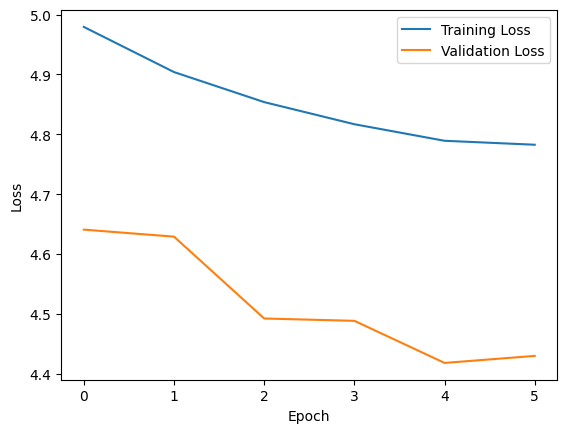

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 6/100, Training Loss: 4.7506, Validation Loss: 4.3945
<class 'float'>


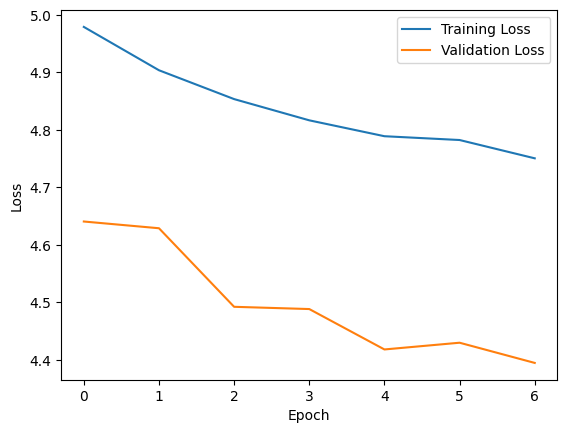

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 7/100, Training Loss: 4.7094, Validation Loss: 4.4102
<class 'float'>


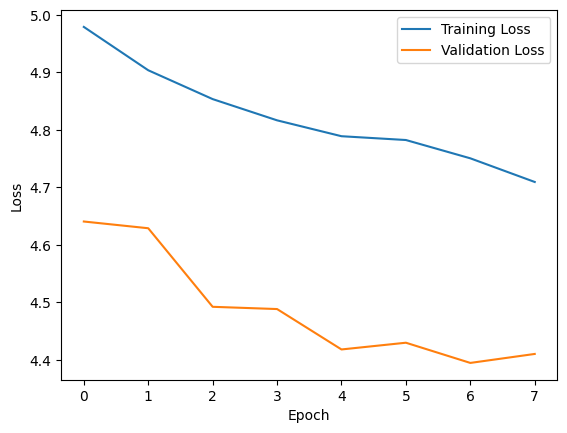

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 8/100, Training Loss: 4.6683, Validation Loss: 4.4180
<class 'float'>


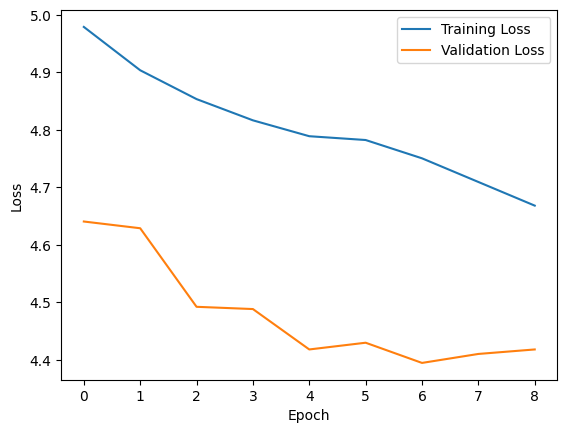

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 9/100, Training Loss: 4.6689, Validation Loss: 4.2812
<class 'float'>


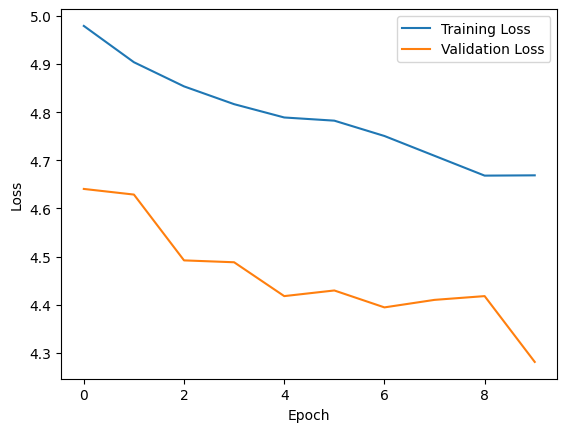

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 10/100, Training Loss: 4.6553, Validation Loss: 4.3555
<class 'float'>


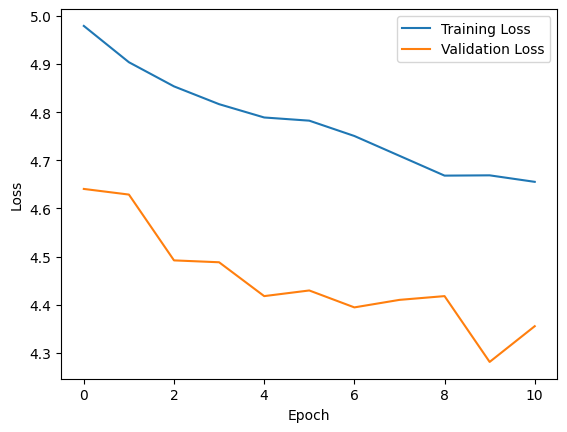

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 11/100, Training Loss: 4.6421, Validation Loss: 4.3281
<class 'float'>


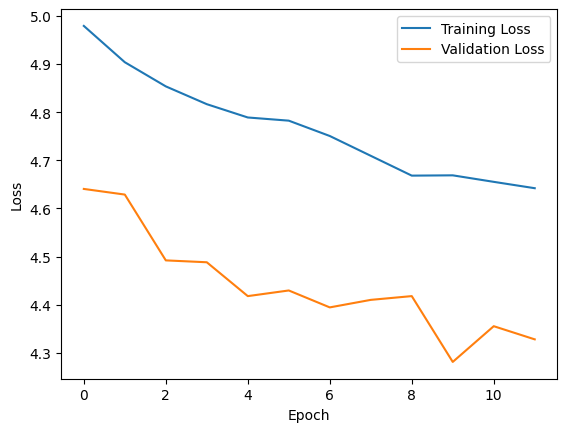

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 12/100, Training Loss: 4.6241, Validation Loss: 4.3242
<class 'float'>


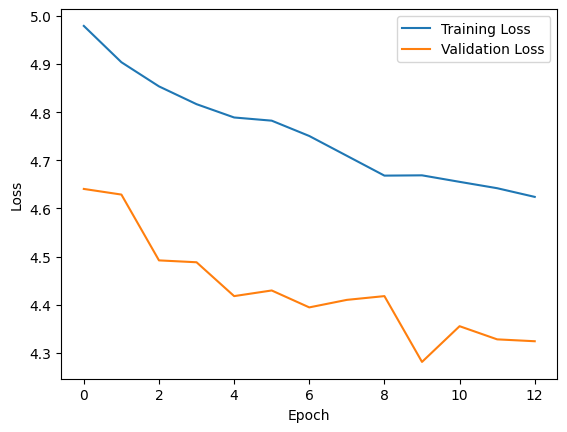

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 13/100, Training Loss: 4.5941, Validation Loss: 4.3359
<class 'float'>


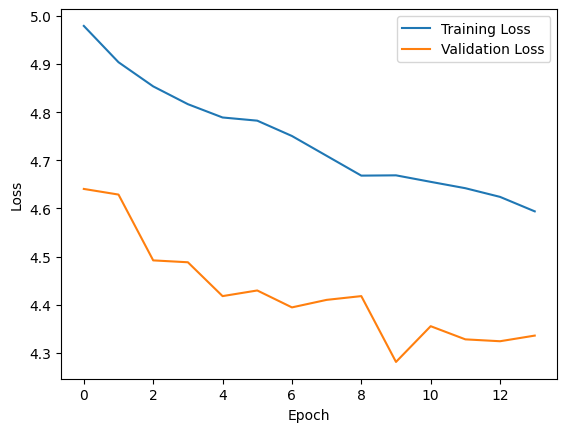

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 14/100, Training Loss: 4.5622, Validation Loss: 4.2773
<class 'float'>


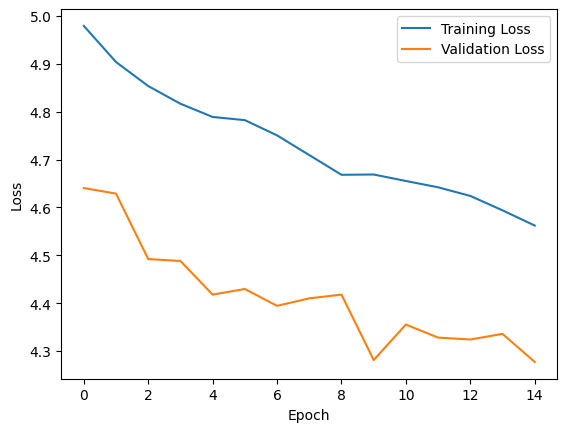

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 15/100, Training Loss: 4.5778, Validation Loss: 4.2578
<class 'float'>


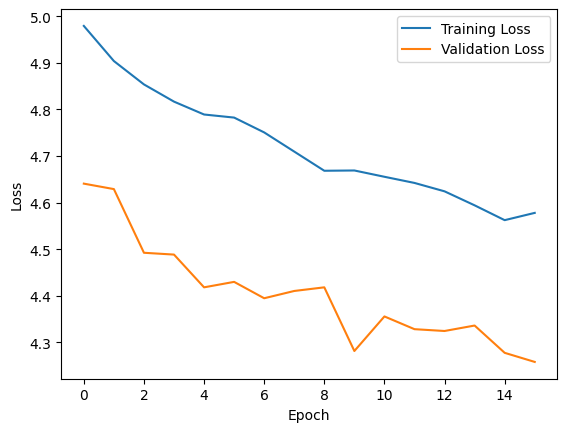

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 16/100, Training Loss: 4.5508, Validation Loss: 4.3672
<class 'float'>


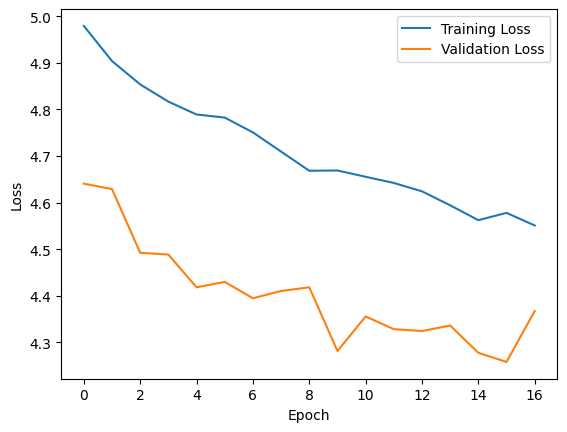

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 17/100, Training Loss: 4.5379, Validation Loss: 4.2266
<class 'float'>


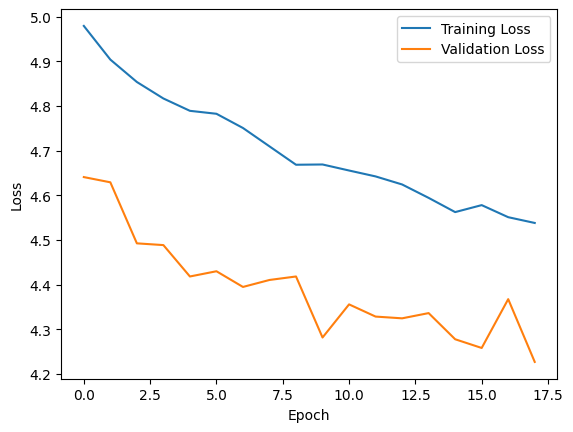

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 18/100, Training Loss: 4.5126, Validation Loss: 4.3164
<class 'float'>


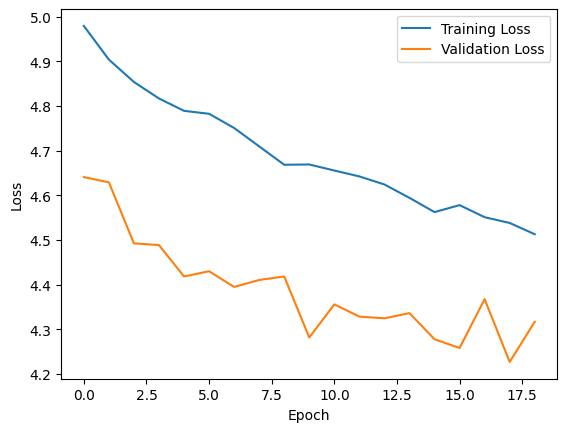

  0%|          | 0/13 [00:00<?, ?it/s]

In [ ]:
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt


patience = 20
num_epochs = 128
best_val_loss = float('inf')
current_patience = 0
optimizer = torch.optim.Adam(model.parameters(), lr=1e-6,betas=(0.9,0.98),eps=1e-6,weight_decay=0.2)
loss_img = nn.CrossEntropyLoss()
loss_txt = nn.CrossEntropyLoss()

# Lists to store training and validation losses
train_losses = []
val_losses = []

# Training loop
for epoch in range(num_epochs):
    model.train()
    pbar = tqdm(train_loader, total=len(train_loader))
    total_train_loss = 0.0

    for batch in pbar:
        optimizer.zero_grad()

        images, texts = batch
        images = images.to(device)
        texts = texts.to(device)
        #texts = torch.reshape(texts, (1, 16, 1, 77))
        # print('text shape',texts.shape)
        # print('image shape',images.shape)

        logits_per_image, logits_per_text = model(images, texts)

        ground_truth = torch.arange(len(images), dtype=torch.long, device=device)
        total_loss = (loss_img(logits_per_image, ground_truth).cpu() + loss_txt(logits_per_text, ground_truth).cpu()) / 2

        total_loss.backward()
        optimizer.step()

        total_train_loss += total_loss.item()
        pbar.set_description(f"Epoch {epoch}/{num_epochs}, Loss: {total_loss.item():.4f}")

    # Calculate training loss
    average_train_loss = total_train_loss / len(train_loader)
    train_losses.append(average_train_loss)

    # Validate and calculate validation loss
    val_loss = validate(model, val_loader, loss_img, loss_txt, device)
    val_losses.append(val_loss)

    # Print and plot losses
    print(f"Epoch {epoch}/{num_epochs}, Training Loss: {average_train_loss:.4f}, Validation Loss: {val_loss:.4f}")

    # Check for early stopping
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        current_patience = 0
        # Save the model when validation loss improves
        torch.save(model.state_dict(), "best_model_with_augmentation.pth")
    else:
        current_patience += 1

    print(type(train_losses[0]))
    # Plot training and validation losses
    #plot_train_losses  = [x.cpu() for x in train_losses]

    #plot_val_losses  = [x.cpu() for x in val_losses]
    plt.plot(train_losses, label='Training Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

    # Check if early stopping condition is met
    if current_patience >= patience:
        print(f"Early stopping after {patience} epochs without improvement.")
        breakfrom tqdm.notebook import tqdm
import matplotlib.pyplot as plt


patience = 20
num_epochs = 200
best_val_loss = float('inf')
current_patience = 0
optimizer = torch.optim.Adam(model.parameters(), lr=1e-6,betas=(0.9,0.98),eps=1e-6,weight_decay=0.2)
loss_img = nn.CrossEntropyLoss()
loss_txt = nn.CrossEntropyLoss()

# Lists to store training and validation losses
train_losses = []
val_losses = []

# Training loop
for epoch in range(num_epochs):
    model.train()
    pbar = tqdm(train_loader, total=len(train_loader))
    total_train_loss = 0.0

    for batch in pbar:
        optimizer.zero_grad()

        images, texts = batch
        images = images.to(device)
        texts = texts.to(device)
        #texts = torch.reshape(texts, (1, 16, 1, 77))
        # print('text shape',texts.shape)
        # print('image shape',images.shape)

        logits_per_image, logits_per_text = model(images, texts)

        ground_truth = torch.arange(len(images), dtype=torch.long, device=device)
        total_loss = (loss_img(logits_per_image, ground_truth).cpu() + loss_txt(logits_per_text, ground_truth).cpu()) / 2

        total_loss.backward()
        optimizer.step()

        total_train_loss += total_loss.item()
        pbar.set_description(f"Epoch {epoch}/{num_epochs}, Loss: {total_loss.item():.4f}")

    # Calculate training loss
    average_train_loss = total_train_loss / len(train_loader)
    train_losses.append(average_train_loss)

    # Validate and calculate validation loss
    val_loss = validate(model, val_loader, loss_img, loss_txt, device)
    val_losses.append(val_loss)

    # Print and plot losses
    print(f"Epoch {epoch}/{num_epochs}, Training Loss: {average_train_loss:.4f}, Validation Loss: {val_loss:.4f}")

    # Check for early stopping
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        current_patience = 0
        # Save the model when validation loss improves
        torch.save(model.state_dict(), "./best_model_with_augmentation1.pth")
    else:
        current_patience += 1

    print(type(train_losses[0]))
    # Plot training and validation losses
    #plot_train_losses  = [x.cpu() for x in train_losses]

    #plot_val_losses  = [x.cpu() for x in val_losses]
    plt.plot(train_losses, label='Training Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

    # Check if early stopping condition is met
    if current_patience >= patience:
        print(f"Early stopping after {patience} epochs without improvement.")
        break

# Not: the output of this finetuning is not present in this dataset, due to GPU limitations in colab the training was done on a local machine
# The final output can be found in the readme file

In [45]:
import clip
import torch

PATH_TO_MODEL_WEIGHTS = 'best_model_with_augmentation1.pth'
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)

state_dict = torch.load(PATH_TO_MODEL_WEIGHTS, map_location='cuda' if torch.cuda.is_available() else 'cpu')
model.load_state_dict(state_dict)
model.cuda().eval()

CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 768, kernel_size=(32, 32), stride=(32, 32), bias=False)
    (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): Sequential(
        (0): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          )
          (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=768, out_features=3072, bias=True)
            (gelu): QuickGELU()
            (c_proj): Linear(in_features=3072, out_features=768, bias=True)
          )
          (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        )
        (1): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          

In [46]:
def calculate_matrix_similarity(list_images_path, model):
    list_embeddings = list()
    images = [preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0).to(device) for img_path in set(list_images_path)]
    for image in set(images):
        #image = preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0).to(device)
        with torch.no_grad():
            embeddings = model.encode_image(image)
        list_embeddings.append(embeddings)
    embeddings = torch.cat(list_embeddings, dim=0)
    normalized_embeddings = embeddings / torch.norm(embeddings, dim=1, keepdim=True)
    similarity_matrix = normalized_embeddings @ normalized_embeddings.T
    return similarity_matrix

In [56]:
similarity_matrix = calculate_matrix_similarity(images_path, model)

result_dict_top1_accuracy, ground_truth_dict =  formating_to_dicts(list_true_y, mean_distribution-1, similarity_matrix, images_path)
accuracy, precision, recall, f1_score, ndcg_score = calculate_metrics(result_dict_top1_accuracy, ground_truth_dict)
print('accuracy', accuracy)
print('precision', precision)
print('recall', recall)
print('f1_score', f1_score)
print('ndcg_score', ndcg_score)

accuracy 2.0408163265306123
precision 2.0408163265306123
recall 0.7142857142857143
f1_score 1.0582010582010581
ndcg_score 2.0408163265306123


In [57]:
result_dict_top1_accuracy, ground_truth_dict =  formating_to_dicts(list_true_y, 8, similarity_matrix, images_path)
accuracy, precision, recall, f1_score, ndcg_score = calculate_metrics(result_dict_top1_accuracy, ground_truth_dict)
print('accuracy', accuracy)
print('precision', precision)
print('recall', recall)
print('f1_score', f1_score)
print('ndcg_score', ndcg_score)

accuracy 36.734693877551024
precision 4.591836734693878
recall 12.857142857142856
f1_score 6.766917293233083
ndcg_score 7.566359537731908


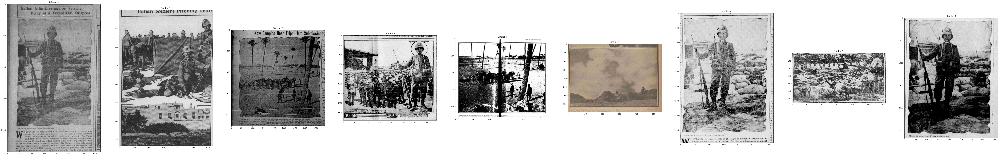

In [58]:
# Plot subplots for the first result
reference_image_path = os.path.join("test_dataset", list(result_dict_top1_accuracy.keys())[1])
similar_images_paths = [os.path.join("test_dataset", img) for img in result_dict_top1_accuracy[list(result_dict_top1_accuracy.keys())[1]]]
plot_subplots(reference_image_path, similar_images_paths)